In [1]:
%matplotlib inline
import numpy as np
import matplotlib.pyplot as plt
import tensorflow as tf
import IPython.display as ipyd
from libs import gif, nb_utils

In [2]:
# Bit of formatting because I don't like the default inline code style:
from IPython.core.display import HTML
HTML("""<style> .rendered_html code { 
    padding: 2px 4px;
    color: #c7254e;
    background-color: #f9f2f4;
    border-radius: 4px;
} </style>""")

In [3]:
sess = tf.InteractiveSession()

In [4]:
from libs import inception
net = inception.get_inception_model()

In [5]:
nb_utils.show_graph(net['graph_def'])

In [6]:
tf.import_graph_def(net['graph_def'], name='inception')

In [7]:
net['labels']

[(0, 'dummy'),
 (1, 'kit fox'),
 (2, 'English setter'),
 (3, 'Siberian husky'),
 (4, 'Australian terrier'),
 (5, 'English springer'),
 (6, 'grey whale'),
 (7, 'lesser panda'),
 (8, 'Egyptian cat'),
 (9, 'ibex'),
 (10, 'Persian cat'),
 (11, 'cougar'),
 (12, 'gazelle'),
 (13, 'porcupine'),
 (14, 'sea lion'),
 (15, 'malamute'),
 (16, 'badger'),
 (17, 'Great Dane'),
 (18, 'Walker hound'),
 (19, 'Welsh springer spaniel'),
 (20, 'whippet'),
 (21, 'Scottish deerhound'),
 (22, 'killer whale'),
 (23, 'mink'),
 (24, 'African elephant'),
 (25, 'Weimaraner'),
 (26, 'soft-coated wheaten terrier'),
 (27, 'Dandie Dinmont'),
 (28, 'red wolf'),
 (29, 'Old English sheepdog'),
 (30, 'jaguar'),
 (31, 'otterhound'),
 (32, 'bloodhound'),
 (33, 'Airedale'),
 (34, 'hyena'),
 (35, 'meerkat'),
 (36, 'giant schnauzer'),
 (37, 'titi'),
 (38, 'three-toed sloth'),
 (39, 'sorrel'),
 (40, 'black-footed ferret'),
 (41, 'dalmatian'),
 (42, 'black-and-tan coonhound'),
 (43, 'papillon'),
 (44, 'skunk'),
 (45, 'Staffordsh

In [8]:
g = tf.get_default_graph()
names = [op.name for op in g.get_operations()]
print(names)

['inception/input', 'inception/conv2d0_w', 'inception/conv2d0_b', 'inception/conv2d1_w', 'inception/conv2d1_b', 'inception/conv2d2_w', 'inception/conv2d2_b', 'inception/mixed3a_1x1_w', 'inception/mixed3a_1x1_b', 'inception/mixed3a_3x3_bottleneck_w', 'inception/mixed3a_3x3_bottleneck_b', 'inception/mixed3a_3x3_w', 'inception/mixed3a_3x3_b', 'inception/mixed3a_5x5_bottleneck_w', 'inception/mixed3a_5x5_bottleneck_b', 'inception/mixed3a_5x5_w', 'inception/mixed3a_5x5_b', 'inception/mixed3a_pool_reduce_w', 'inception/mixed3a_pool_reduce_b', 'inception/mixed3b_1x1_w', 'inception/mixed3b_1x1_b', 'inception/mixed3b_3x3_bottleneck_w', 'inception/mixed3b_3x3_bottleneck_b', 'inception/mixed3b_3x3_w', 'inception/mixed3b_3x3_b', 'inception/mixed3b_5x5_bottleneck_w', 'inception/mixed3b_5x5_bottleneck_b', 'inception/mixed3b_5x5_w', 'inception/mixed3b_5x5_b', 'inception/mixed3b_pool_reduce_w', 'inception/mixed3b_pool_reduce_b', 'inception/mixed4a_1x1_w', 'inception/mixed4a_1x1_b', 'inception/mixed4a_3

In [9]:
input_name = names[0] + ":0"
x = g.get_tensor_by_name(input_name)

In [10]:
input_name

'inception/input:0'

In [11]:
names[-1] + ':0'

'inception/output2:0'

In [12]:
softmax = g.get_tensor_by_name(names[-1] + ':0')

In [13]:
softmax.get_shape()

TensorShape([Dimension(None), Dimension(1008)])

0 255


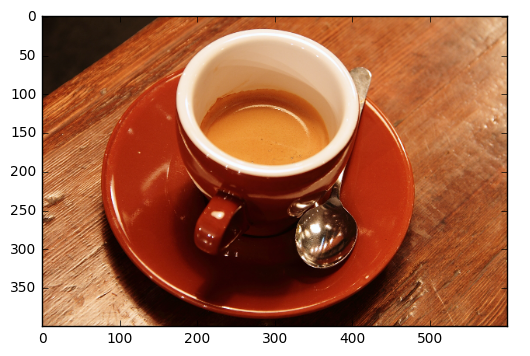

In [14]:
from skimage.data import coffee
og = coffee()
plt.imshow(og)
print(og.min(), og.max())

In [15]:
img = inception.preprocess(og)

In [16]:
print(og.shape),print(img.shape)

(400, 600, 3)
(299, 299, 3)


(None, None)

In [17]:
print(img.min(), img.max())

-117.0 138.0


In [18]:
img_4d = img[np.newaxis]
print(img_4d.shape)

(1, 299, 299, 3)


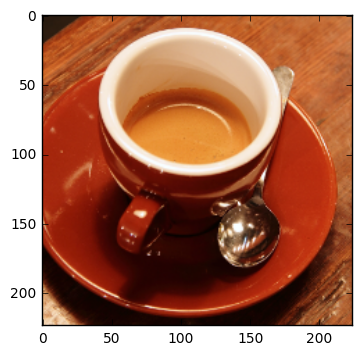

In [117]:
plt.imshow(img)

In [120]:
img[:3,:3]

array([[[ 0.1544818 ,  0.1035014 ,  0.06036415],
        [ 0.15770309,  0.10672269,  0.06358544],
        [ 0.1544818 ,  0.1035014 ,  0.06495598]],

       [[ 0.15658763,  0.10560724,  0.06246999],
        [ 0.16215487,  0.11117447,  0.06803721],
        [ 0.15618747,  0.10520709,  0.06206983]],

       [[ 0.15451181,  0.10353141,  0.05958384],
        [ 0.1637505 ,  0.11277011,  0.06963285],
        [ 0.1605092 ,  0.10952881,  0.06639156]]], dtype=float32)

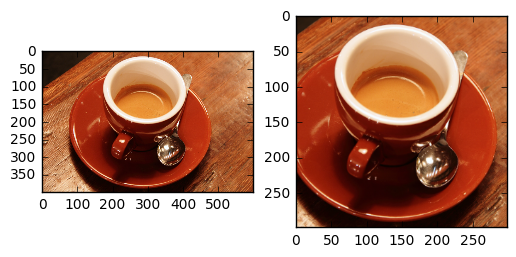

In [19]:
fig, axs = plt.subplots(1, 2)
axs[0].imshow(og)
axs[1].imshow(inception.deprocess(img))

In [20]:
img_4d.shape

(1, 299, 299, 3)

In [22]:
res = softmax.eval(feed_dict={x: img_4d})

In [23]:
res.shape

(16, 1008)

In [24]:
np.squeeze(res)

array([[  1.08247465e-14,   1.91724319e-17,   1.59638166e-12, ...,
          1.08240460e-14,   1.08253259e-14,   1.08247888e-14],
       [  1.43945848e-15,   1.36372873e-18,   2.80957739e-13, ...,
          1.43935970e-15,   1.43953535e-15,   1.43946399e-15],
       [  2.74944269e-15,   2.86159328e-18,   4.06765848e-13, ...,
          2.74925401e-15,   2.74958944e-15,   2.74945328e-15],
       ..., 
       [  1.24471602e-14,   3.66610186e-17,   5.05053161e-12, ...,
          1.24463055e-14,   1.24477768e-14,   1.24471602e-14],
       [  2.28704317e-14,   7.87223620e-17,   7.89168036e-12, ...,
          2.28688613e-14,   2.28716091e-14,   2.28704757e-14],
       [  3.93821558e-13,   2.98510462e-15,   6.53753926e-11, ...,
          3.93794535e-13,   3.93841860e-13,   3.93822317e-13]], dtype=float32)

In [25]:
res.shape

(16, 1008)

In [26]:
res

array([[  1.08247465e-14,   1.91724319e-17,   1.59638166e-12, ...,
          1.08240460e-14,   1.08253259e-14,   1.08247888e-14],
       [  1.43945848e-15,   1.36372873e-18,   2.80957739e-13, ...,
          1.43935970e-15,   1.43953535e-15,   1.43946399e-15],
       [  2.74944269e-15,   2.86159328e-18,   4.06765848e-13, ...,
          2.74925401e-15,   2.74958944e-15,   2.74945328e-15],
       ..., 
       [  1.24471602e-14,   3.66610186e-17,   5.05053161e-12, ...,
          1.24463055e-14,   1.24477768e-14,   1.24471602e-14],
       [  2.28704317e-14,   7.87223620e-17,   7.89168036e-12, ...,
          2.28688613e-14,   2.28716091e-14,   2.28704757e-14],
       [  3.93821558e-13,   2.98510462e-15,   6.53753926e-11, ...,
          3.93794535e-13,   3.93841860e-13,   3.93822317e-13]], dtype=float32)

In [27]:
res = np.mean(res, 0)
res = res / np.sum(res)

In [28]:
res

array([  3.95740501e-14,   2.34581566e-16,   7.38100640e-12, ...,
         3.95713363e-14,   3.95760898e-14,   3.95741247e-14], dtype=float32)

In [29]:
print([(res[idx],net['labels'][idx]) for idx in res.argsort()[-5:][::-1]])

[(0.99849206, (947, 'espresso')), (0.000631253, (859, 'cup')), (0.00050241494, (953, 'chocolate sauce')), (0.00019483209, (844, 'consomme')), (0.00013370356, (822, 'soup bowl'))]


# Visualize Filters

In [30]:
W = g.get_tensor_by_name('inception/conv2d0_w:0')
W_eval = W.eval()
print(W_eval.shape)

(7, 7, 3, 64)


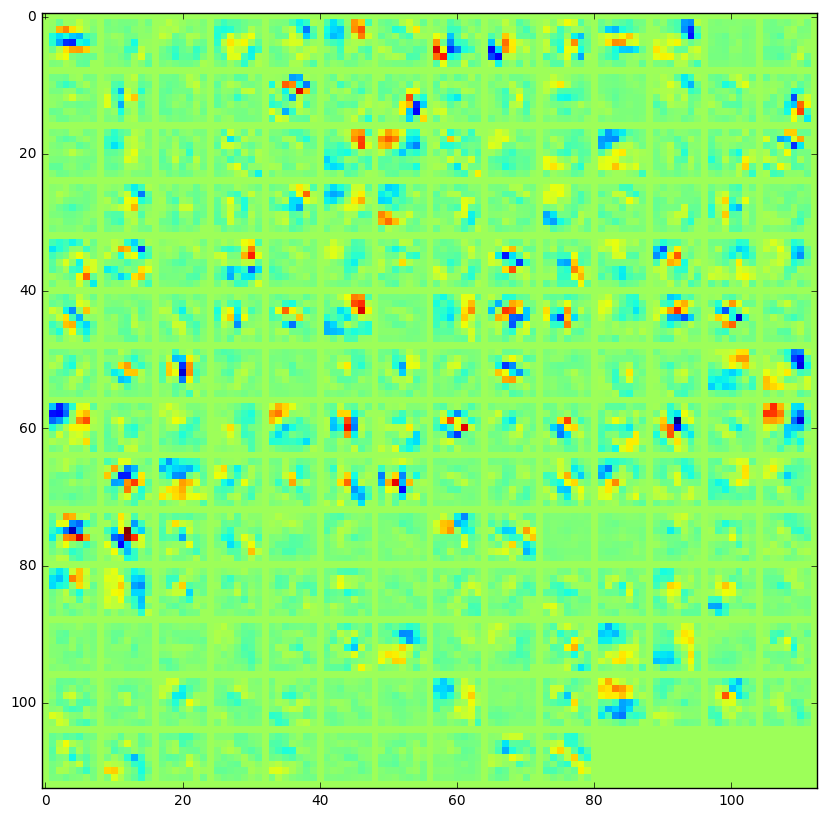

In [31]:
from libs import utils
W_montage = utils.montage_filters(W_eval)
plt.figure(figsize=(10,10))
plt.imshow(W_montage, interpolation='nearest')

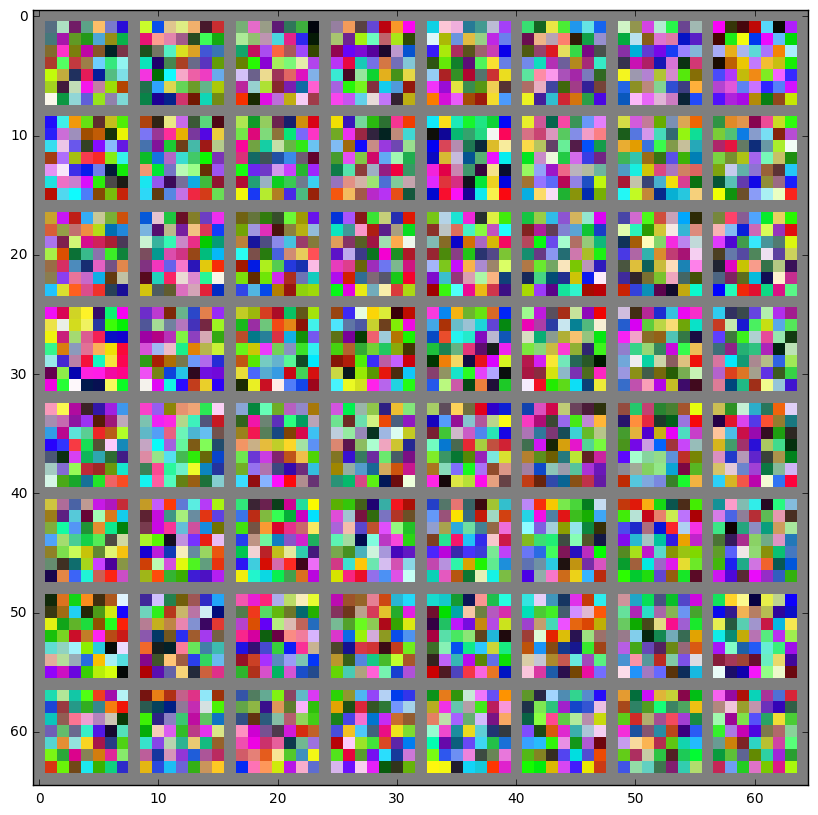

In [32]:
Ws = [utils.montage_filters(W_eval[:,:,[i],:]) for i in range(3)]
Ws = np.rollaxis(np.array(Ws), 0, 3)
plt.figure(figsize=(10, 10))
plt.imshow(Ws, interpolation='nearest')

In [33]:
np.min(Ws), np.max(Ws)

(-6.4092006683349609, 6.3349862098693848)

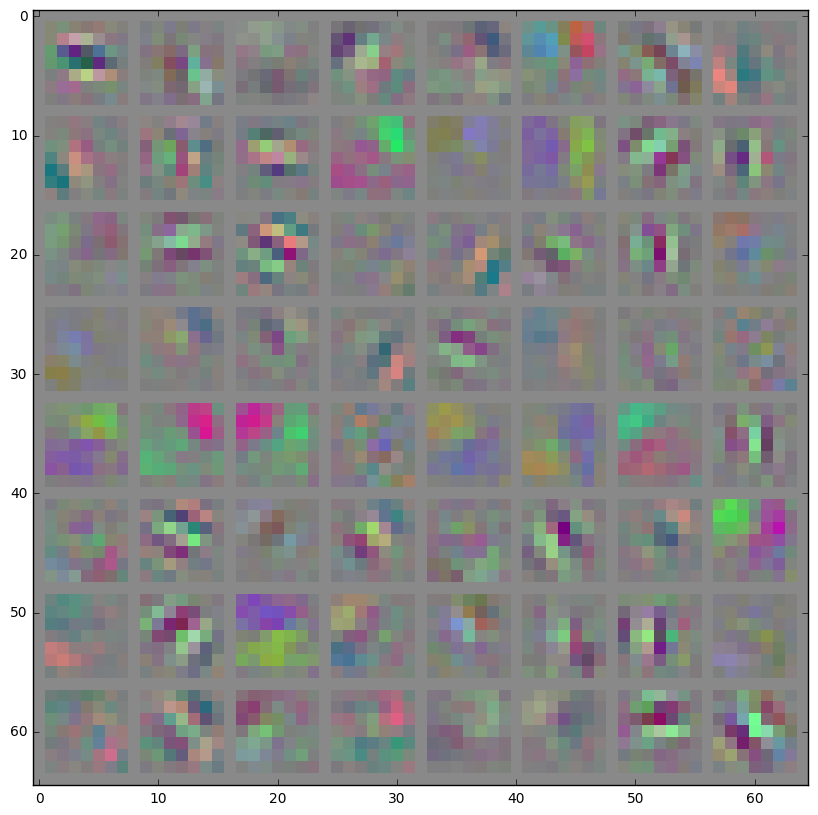

In [34]:
Ws = (Ws/ np.max(np.abs(Ws))* 128+128).astype(np.uint8)
plt.figure(figsize=(10, 10))
plt.imshow(Ws, interpolation='nearest')

In [35]:
feature = g.get_tensor_by_name('inception/conv2d0_pre_relu:0')

In [36]:
layer_shape = tf.shape(feature).eval(feed_dict={x:img_4d})
print(layer_shape)

[  1 150 150  64]


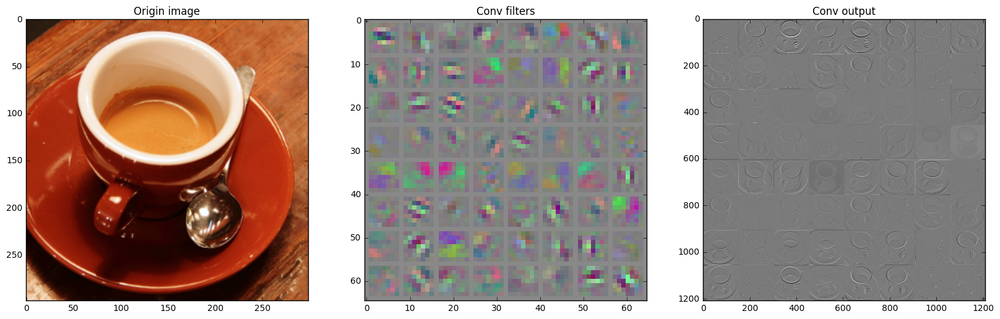

In [37]:
f = feature.eval(feed_dict={ x : img_4d})
montage = utils.montage_filters(np.rollaxis(np.expand_dims(f[0],3),3, 2))
fig, axs = plt.subplots(1, 3, figsize=(20, 10))
axs[0].imshow(inception.deprocess(img))
axs[0].set_title("Origin image")
axs[1].imshow(Ws, interpolation='nearest')
axs[1].set_title("Conv filters")
axs[2].imshow(montage, cmap='gray')
axs[2].set_title("Conv output")

# Visualizing the Gradient

In [38]:
feature.eval(feed_dict={x:img_4d}).shape

(1, 150, 150, 64)

In [39]:
tf.reduce_max(feature, 3).eval(feed_dict={x:img_4d}).shape

(1, 150, 150)

In [40]:
x.eval(feed_dict={x:img_4d}).shape

(1, 299, 299, 3)

In [41]:
feature = g.get_tensor_by_name('inception/conv2d0_pre_relu:0')
gradient = tf.gradients(tf.reduce_max(feature, 3), x)

In [42]:
len(sess.run(gradient, feed_dict={x: img_4d}))

1

In [43]:
res = sess.run(gradient, feed_dict={x: img_4d})[0]

In [44]:
res.shape

(1, 299, 299, 3)

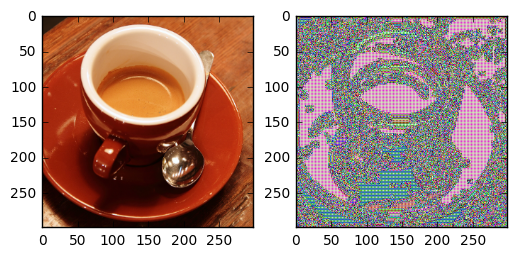

In [45]:
fig, axs = plt.subplots(1, 2)
axs[0].imshow(inception.deprocess(img))
axs[1].imshow(res[0])

In [46]:
def normalize(img, s=0.1):
    """
    Normalize the image range for visualization
    """
    z = img/np.std(img)
    return np.uint8(np.clip(
                (z - z.mean())/max(z.std(), 1e-4)*s + 0.5,0, 1)*255)

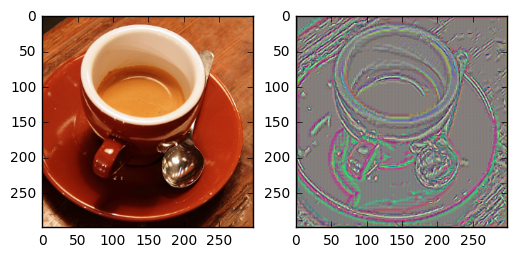

In [47]:
r = normalize(res)
fig, axs = plt.subplots(1, 2)
axs[0].imshow(inception.deprocess(img))
axs[1].imshow(r[0])

In [48]:
def compute_gradient(input_placeholder, img, layer_name, neuron_i):
    feature = g.get_tensor_by_name(layer_name)
    gradient = tf.gradients(tf.reduce_mean(feature[:, :, :, neuron_i]), x)
    res = sess.run(gradient, feed_dict={input_placeholder:img})[0]
    return res

def compute_gradients(input_placeholder, img, layer_name):
    feature = g.get_tensor_by_name(layer_name)
    layer_shape = tf.shape(feature).eval(feed_dict={input_placeholder: img})
    gradients = []
    for neuron_i in range(layer_shape[-1]):
        gradients.append(compute_gradient(input_placeholder, img, layer_name, neuron_i))
    return gradients

In [49]:
gradients = compute_gradients(x, img_4d, 'inception/conv2d1_pre_relu:0')
gradients_norm =  [normalize(gradient_i[0]) for gradient_i in gradients]
motange = utils.montage(np.array(gradients_norm))

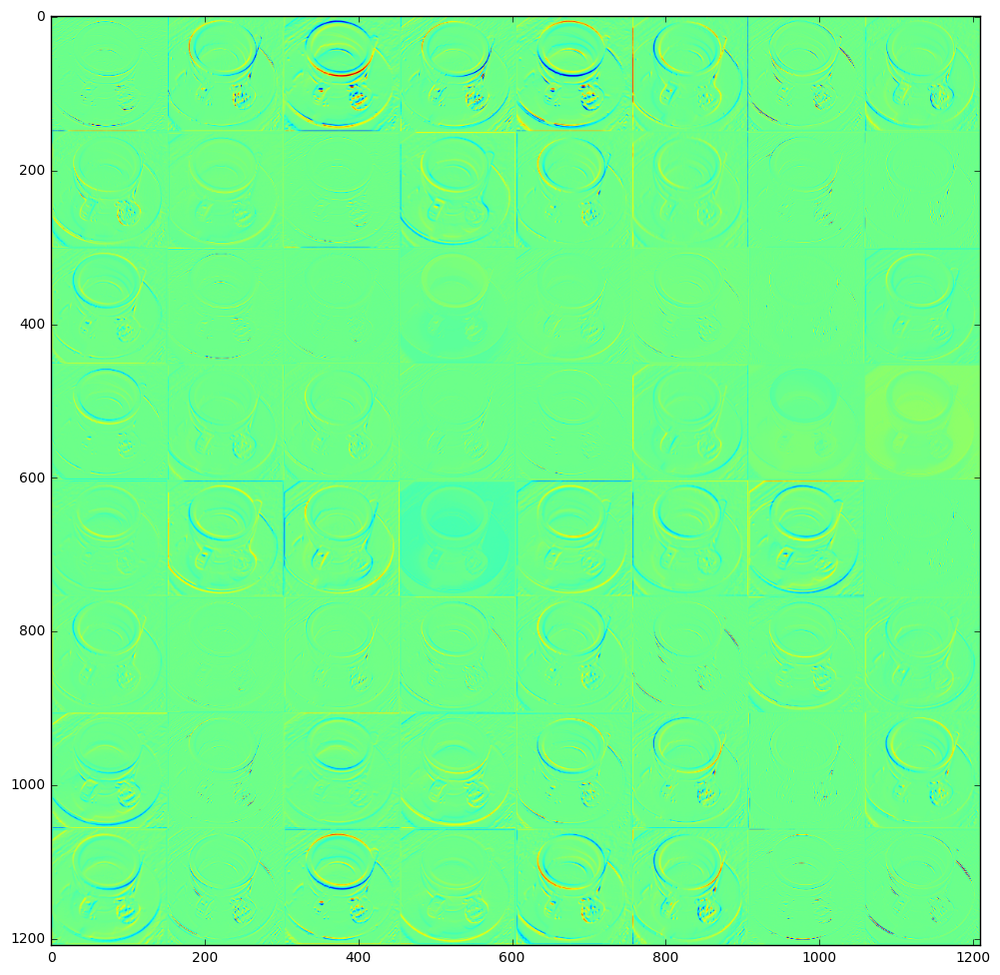

In [50]:
plt.figure(figsize=(12, 12))
plt.imshow(montage)

In [51]:
features = [name for name in names if 'maxpool' in name.split('/')[-1]]
print(features)

['inception/maxpool0', 'inception/maxpool1', 'inception/maxpool4', 'inception/maxpool10']


In [52]:
g.get_tensor_by_name('inception/maxpool0:0').eval(feed_dict={x:img_4d}).shape

(1, 75, 75, 64)

5.90585e+06
115560.0
203146.0
24223.5


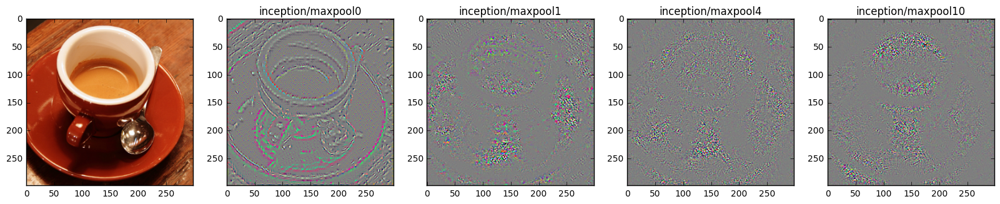

In [53]:
n_plots = len(features) + 1
fig, axs= plt.subplots(1, n_plots, figsize=(20, 5))
base = img_4d
axs[0].imshow(inception.deprocess(img))
for feature_i, featurename in enumerate(features):
    feature = g.get_tensor_by_name(featurename+':0')
    neuron = tf.reduce_max(feature, len(feature.get_shape())-1)
    print(tf.reduce_sum(neuron).eval(feed_dict={x : base}))
    # 나머지 픽셀들은 다 상수로보고 해당 픽셀 하나 가지고만 미분해서!!
    gradient = tf.gradients(tf.reduce_sum(neuron), x)
    this_res = sess.run(gradient[0], feed_dict={x : base})[0]
    axs[feature_i+1].imshow(normalize(this_res))
    axs[feature_i+1].set_title(featurename)

# Deep Dreaming

0, 1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12, 13, 14, 15, 16, 17, 18, 19, 20, 21, 22, 23, 24, 25, 26, 27, 28, 29, 30, 31, 32, 33, 34, 35, 36, 37, 38, 39, 40, 41, 42, 43, 44, 45, 46, 47, 48, 49, 

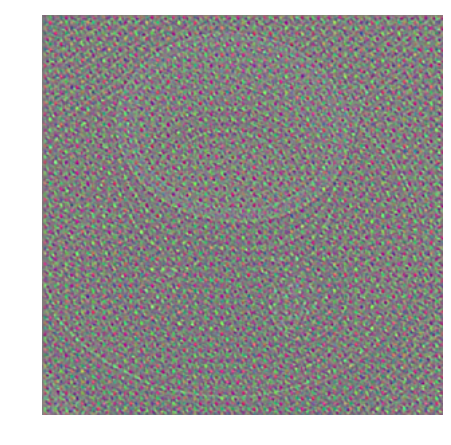

In [54]:
img_4d = img_4d / np.max(img_4d)

layer = g.get_tensor_by_name('inception/maxpool0:0')

gradient = tf.gradients(tf.reduce_mean(layer), x)

img_copy = img_4d.copy()

n_iterations = 50

step = 1.0

gif_step = 10

imgs = []
for it_i in range(n_iterations):
    print(it_i, end=', ')
    
    this_res = sess.run(gradient[0], feed_dict={x:img_copy})[0]
    this_res /= (np.max(np.abs(this_res)) + 1e-8)
    
    img_copy += this_res * step
    
    if it_i % gif_step == 0:
        imgs.append(normalize(img_copy[0]))

gif.build_gif(imgs, saveto='1-simplest-mean-layer.gif')

In [55]:
ipyd.Image(url='1-simplest-mean-layer.gif',height=200, width=200)

In [56]:
neuron = tf.reduce_max(layer, len(layer.get_shape())-1)
gradient = tf.gradients(tf.reduce_mean(neuron),x )

0, 1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12, 13, 14, 15, 16, 17, 18, 19, 20, 21, 22, 23, 24, 25, 26, 27, 28, 29, 30, 31, 32, 33, 34, 35, 36, 37, 38, 39, 40, 41, 42, 43, 44, 45, 46, 47, 48, 49, 

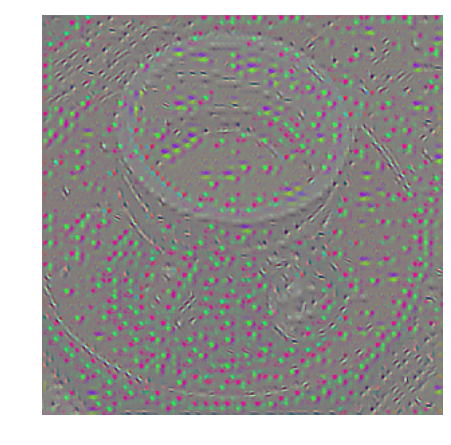

In [57]:
img_copy = img_4d.copy()
imgs = []
for it_i in range(n_iterations):
    print(it_i, end=', ')
    this_res = sess.run(gradient[0], feed_dict = {x : img_copy})[0]
    this_res /= (np.max(np.abs(this_res))+ 1e-8)
    img_copy += this_res * step
    if it_i % gif_step == 0:
        imgs.append(normalize(img_copy[0]))
gif.build_gif(imgs, saveto='1-simplest-max-neuron.gif')

In [58]:
ipyd.Image(url='1-simplest-max-neuron.gif', height=200, width=200)

0, 10, 20, 30, 40, 0, 10, 20, 30, 40, 0, 10, 20, 30, 40, 0, 10, 20, 30, 40, 

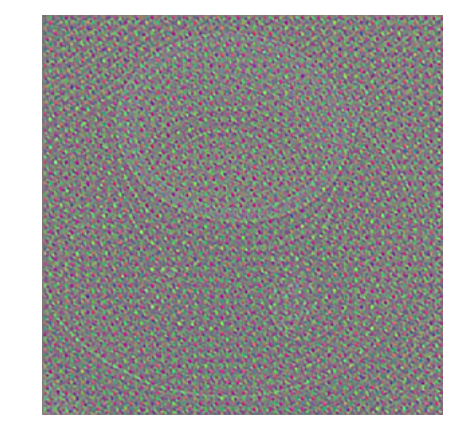

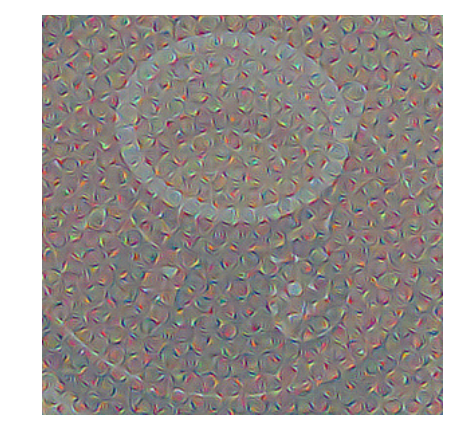

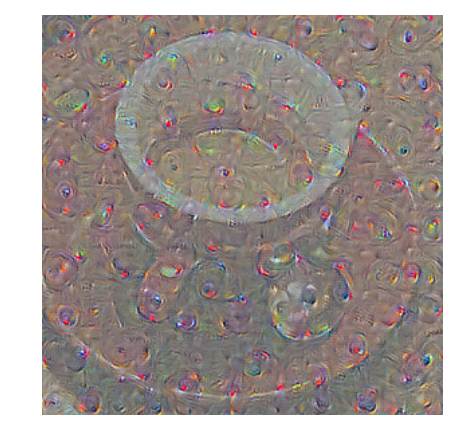

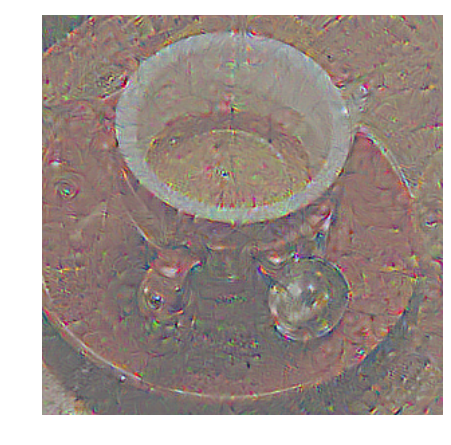

In [59]:
for feature_i in features:
    layer = g.get_tensor_by_name(feature_i + ':0')
    gradient = tf.gradients(tf.reduce_mean(layer), x)
    img_copy = img_4d.copy()
    imgs = []
    for it_i in range(n_iterations):
        if it_i % 10 == 0:
            print(it_i, end=', ')
        this_res = sess.run(gradient[0], feed_dict={x:img_copy})[0]
        this_res /= (np.max(np.abs(this_res))+ 1e-8)
        img_copy += this_res * step
        if it_i % gif_step == 0:
            imgs.append(normalize(img_copy[0]))
    gif.build_gif(imgs, saveto='1-simplest-'+feature_i.split('/')[-1]+'.gif')

In [60]:
img_noise = inception.preprocess((np.random.randint(100, 150, size = (299, 299,3), dtype=np.uint8)))[np.newaxis]
print(img_noise.min(), img_noise.max())

-17.0 32.0


In [61]:
img_noise.shape

(1, 299, 299, 3)

0, 1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12, 13, 14, 15, 16, 17, 18, 19, 20, 21, 22, 23, 24, 25, 26, 27, 28, 29, 30, 31, 32, 33, 34, 35, 36, 37, 38, 39, 40, 41, 42, 43, 44, 45, 46, 47, 48, 49, 0, 1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12, 13, 14, 15, 16, 17, 18, 19, 20, 21, 22, 23, 24, 25, 26, 27, 28, 29, 30, 31, 32, 33, 34, 35, 36, 37, 38, 39, 40, 41, 42, 43, 44, 45, 46, 47, 48, 49, 0, 1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12, 13, 14, 15, 16, 17, 18, 19, 20, 21, 22, 23, 24, 25, 26, 27, 28, 29, 30, 31, 32, 33, 34, 35, 36, 37, 38, 39, 40, 41, 42, 43, 44, 45, 46, 47, 48, 49, 0, 1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12, 13, 14, 15, 16, 17, 18, 19, 20, 21, 22, 23, 24, 25, 26, 27, 28, 29, 30, 31, 32, 33, 34, 35, 36, 37, 38, 39, 40, 41, 42, 43, 44, 45, 46, 47, 48, 49, 

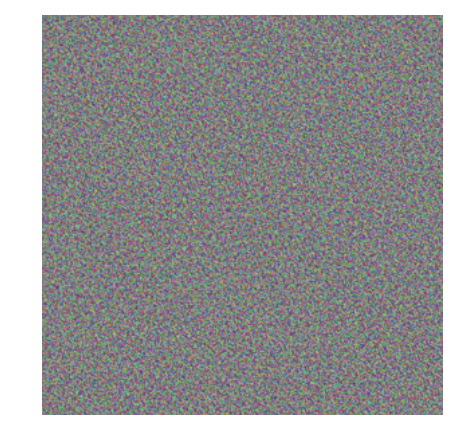

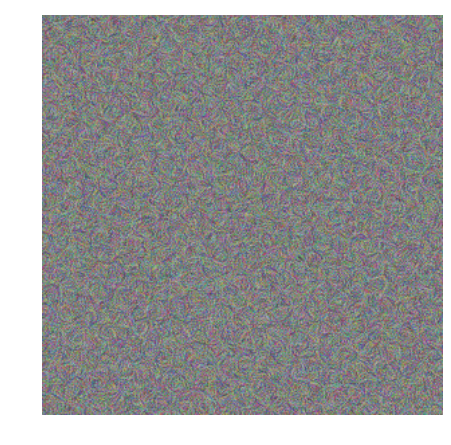

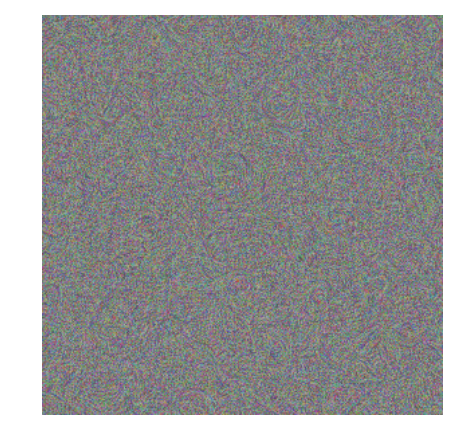

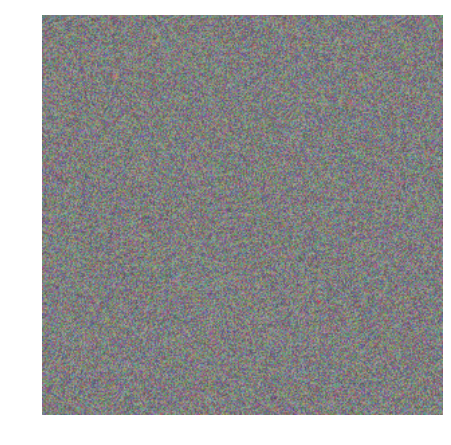

In [62]:
for feature_i in features: 
    layer = g.get_tensor_by_name(feature_i + ':0')
    gradient = tf.gradients(tf.reduce_mean(layer), x)
    img_copy = img_noise.copy()
    imgs = []
    for it_i in range(n_iterations):
        print(it_i, end=', ')
        this_res = sess.run(gradient[0], feed_dict={x: img_copy})[0]
        this_res /= (np.max(np.abs(this_res))+ 1e-8)
        img_copy += this_res*step
        if it_i % gif_step == 0:
            imgs.append(normalize(img_copy[0]))
    gif.build_gif(
        imgs, saveto='1-simplest-noise-'+feature_i.split('/')[-1]+'.gif')

# Specifying the Object

In [63]:
layer = g.get_tensor_by_name('inception/mixed5b_pool_reduce_pre_relu:0')

layer_shape = tf.shape(layer).eval(feed_dict={x:img_4d})
n_els = tf.shape(layer).eval(feed_dict={x:img_4d})[-1]

neuron_i = np.random.randint(n_els)
layer_vec = np.zeros(layer_shape)

layer_vec[..., neuron_i] = 1

neuron = tf.reduce_max(layer, len(layer.get_shape()) -1 )
gradient = tf.gradients(tf.reduce_mean(neuron), x)

0, 1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12, 13, 14, 15, 16, 17, 18, 19, 20, 21, 22, 23, 24, 25, 26, 27, 28, 29, 0, 1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12, 13, 14, 15, 16, 17, 18, 19, 20, 21, 22, 23, 24, 25, 26, 27, 28, 29, 0, 1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12, 13, 14, 15, 16, 17, 18, 19, 20, 21, 22, 23, 24, 25, 26, 27, 28, 29, 0, 1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12, 13, 14, 15, 16, 17, 18, 19, 20, 21, 22, 23, 24, 25, 26, 27, 28, 29, 0, 1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12, 13, 14, 15, 16, 17, 18, 19, 20, 21, 22, 23, 24, 25, 26, 27, 28, 29, 

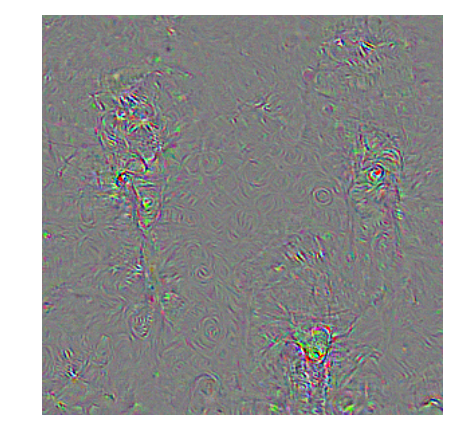

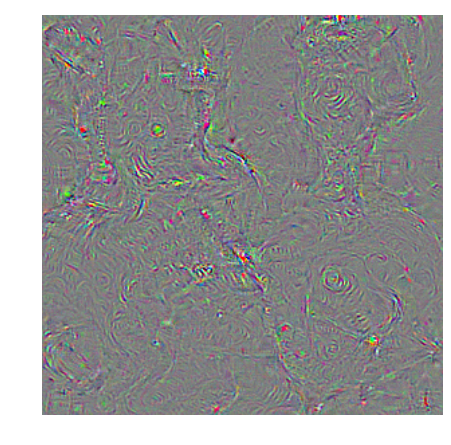

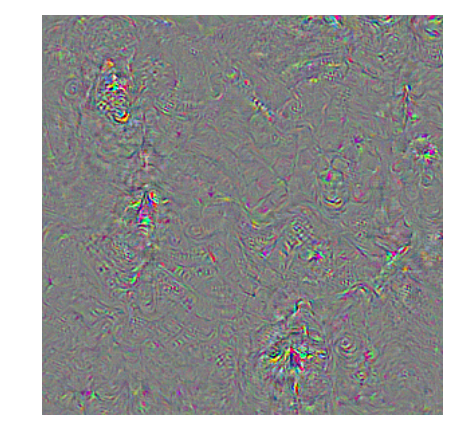

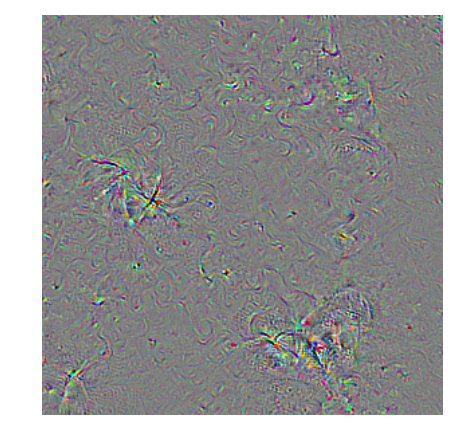

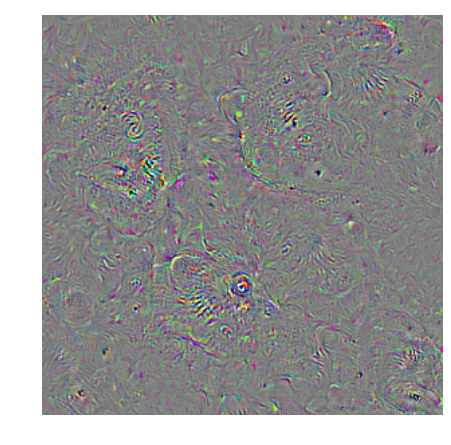

In [64]:
n_iterations = 30

for i in range(5):
    neuron_i = np.random.randint(n_els)
    layer_vec = np.zeros(layer_shape)
    layer_vec[..., neuron_i] = 1
    img_copy = img_noise.copy()/255.0
    imgs = []
    for it_i in range(n_iterations):
        print(it_i, end=', ')
        this_res = sess.run(gradient[0], feed_dict={x: img_copy, layer: layer_vec})[0]
        this_res /= (np.max(np.abs(this_res)) + 1e-8)
        img_copy += this_res*step 
        if it_i % gif_step == 0 :
            imgs.append(normalize(img_copy[0]))
    gif.build_gif(imgs, saveto='2-objective-' + str(neuron_i) + '.gif')

In [65]:
net['labels']

[(0, 'dummy'),
 (1, 'kit fox'),
 (2, 'English setter'),
 (3, 'Siberian husky'),
 (4, 'Australian terrier'),
 (5, 'English springer'),
 (6, 'grey whale'),
 (7, 'lesser panda'),
 (8, 'Egyptian cat'),
 (9, 'ibex'),
 (10, 'Persian cat'),
 (11, 'cougar'),
 (12, 'gazelle'),
 (13, 'porcupine'),
 (14, 'sea lion'),
 (15, 'malamute'),
 (16, 'badger'),
 (17, 'Great Dane'),
 (18, 'Walker hound'),
 (19, 'Welsh springer spaniel'),
 (20, 'whippet'),
 (21, 'Scottish deerhound'),
 (22, 'killer whale'),
 (23, 'mink'),
 (24, 'African elephant'),
 (25, 'Weimaraner'),
 (26, 'soft-coated wheaten terrier'),
 (27, 'Dandie Dinmont'),
 (28, 'red wolf'),
 (29, 'Old English sheepdog'),
 (30, 'jaguar'),
 (31, 'otterhound'),
 (32, 'bloodhound'),
 (33, 'Airedale'),
 (34, 'hyena'),
 (35, 'meerkat'),
 (36, 'giant schnauzer'),
 (37, 'titi'),
 (38, 'three-toed sloth'),
 (39, 'sorrel'),
 (40, 'black-footed ferret'),
 (41, 'dalmatian'),
 (42, 'black-and-tan coonhound'),
 (43, 'papillon'),
 (44, 'skunk'),
 (45, 'Staffordsh

In [66]:
type(net['labels'])

list

In [67]:
neuron_i = 962
print(net['labels'][neuron_i])

(962, 'school bus')


In [68]:
layer = g.get_tensor_by_name(names[-1] + ':0')
gradient = tf.gradients(tf.reduce_max(layer), x)
layer_shape = tf.shape(layer).eval(feed_dict = {x: img_noise})
layer_vec = np.zeros(layer_shape)
layer_vec[..., neuron_i]= 1

0, 1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12, 13, 14, 15, 16, 17, 18, 19, 20, 21, 22, 23, 24, 25, 26, 27, 28, 29, 30, 31, 32, 33, 34, 35, 36, 37, 38, 39, 40, 41, 42, 43, 44, 45, 46, 47, 48, 49, 50, 51, 52, 53, 54, 55, 56, 57, 58, 59, 60, 61, 62, 63, 64, 65, 66, 67, 68, 69, 70, 71, 72, 73, 74, 75, 76, 77, 78, 79, 80, 81, 82, 83, 84, 85, 86, 87, 88, 89, 90, 91, 92, 93, 94, 95, 96, 97, 98, 99, 100, 101, 102, 103, 104, 105, 106, 107, 108, 109, 110, 111, 112, 113, 114, 115, 116, 117, 118, 119, 120, 121, 122, 123, 124, 125, 126, 127, 128, 129, 130, 131, 132, 133, 134, 135, 136, 137, 138, 139, 140, 141, 142, 143, 144, 145, 146, 147, 148, 149, 150, 151, 152, 153, 154, 155, 156, 157, 158, 159, 160, 161, 162, 163, 164, 165, 166, 167, 168, 169, 170, 171, 172, 173, 174, 175, 176, 177, 178, 179, 180, 181, 182, 183, 184, 185, 186, 187, 188, 189, 190, 191, 192, 193, 194, 195, 196, 197, 198, 199, 200, 201, 202, 203, 204, 205, 206, 207, 208, 209, 210, 211, 212, 213, 214, 215, 216, 217, 218, 219, 220, 221, 

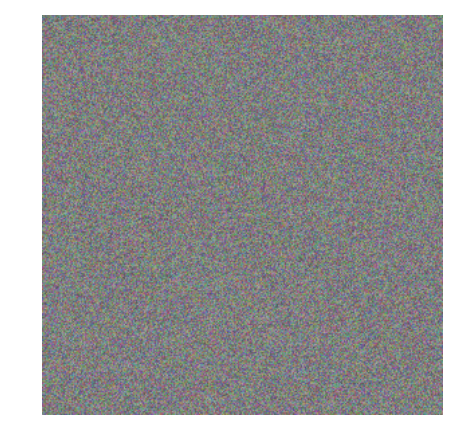

In [69]:
n_iterations = 300
gif_step = 10
img_copy = img_noise.copy()
imgs = []
for it_i in range(n_iterations):
    print(it_i, end=', ')
    this_res = sess.run(gradient[0], feed_dict={x: img_copy, layer: layer_vec})[0]
    this_res /= (np.max(np.abs(this_res))+ 1e-8)
    img_copy += this_res * step
    if it_i % gif_step == 0:
        imgs.append(normalize(img_copy[0]))
gif.build_gif(imgs, saveto='2-object-'+str(neuron_i) + '.gif')

In [70]:
# Test

(1, 299, 299, 3)
[[  8.24721383e-07   4.71827934e-06   2.37829249e-06 ...,   8.24660788e-07
    8.24756739e-07   8.24716608e-07]
 [  5.63233129e-07   3.81949076e-06   2.16509738e-06 ...,   5.63191236e-07
    5.63256776e-07   5.63229889e-07]
 [  7.32622880e-07   5.48676553e-06   3.57502881e-06 ...,   7.32569163e-07
    7.32653632e-07   7.32618730e-07]
 ..., 
 [  7.09356129e-07   4.18898117e-06   4.94060123e-06 ...,   7.09304004e-07
    7.09386597e-07   7.09352094e-07]
 [  1.00580951e-06   6.07782295e-06   7.02177840e-06 ...,   1.00573459e-06
    1.00585066e-06   1.00580371e-06]
 [  1.85943577e-06   1.27278108e-05   1.40989669e-05 ...,   1.85929753e-06
    1.85951376e-06   1.85942520e-06]]


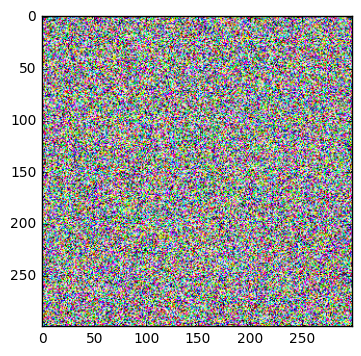

In [71]:

test = inception.preprocess(imgs[2])
plt.imshow(test)
test = test[np.newaxis]

print(test.shape)

output = g.get_tensor_by_name(names[-1]+':0')

res = sess.run(output, feed_dict={x: test})
print(res)

In [72]:
dict(net['labels'])[np.argmax(res[0])]

'shower curtain'

# Decaying the Gradient

0, 1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12, 13, 14, 15, 16, 17, 18, 19, 20, 21, 22, 23, 24, 25, 26, 27, 28, 29, 30, 31, 32, 33, 34, 35, 36, 37, 38, 39, 40, 41, 42, 43, 44, 45, 46, 47, 48, 49, 50, 51, 52, 53, 54, 55, 56, 57, 58, 59, 60, 61, 62, 63, 64, 65, 66, 67, 68, 69, 70, 71, 72, 73, 74, 75, 76, 77, 78, 79, 80, 81, 82, 83, 84, 85, 86, 87, 88, 89, 90, 91, 92, 93, 94, 95, 96, 97, 98, 99, 100, 101, 102, 103, 104, 105, 106, 107, 108, 109, 110, 111, 112, 113, 114, 115, 116, 117, 118, 119, 120, 121, 122, 123, 124, 125, 126, 127, 128, 129, 130, 131, 132, 133, 134, 135, 136, 137, 138, 139, 140, 141, 142, 143, 144, 145, 146, 147, 148, 149, 150, 151, 152, 153, 154, 155, 156, 157, 158, 159, 160, 161, 162, 163, 164, 165, 166, 167, 168, 169, 170, 171, 172, 173, 174, 175, 176, 177, 178, 179, 180, 181, 182, 183, 184, 185, 186, 187, 188, 189, 190, 191, 192, 193, 194, 195, 196, 197, 198, 199, 200, 201, 202, 203, 204, 205, 206, 207, 208, 209, 210, 211, 212, 213, 214, 215, 216, 217, 218, 219, 220, 221, 

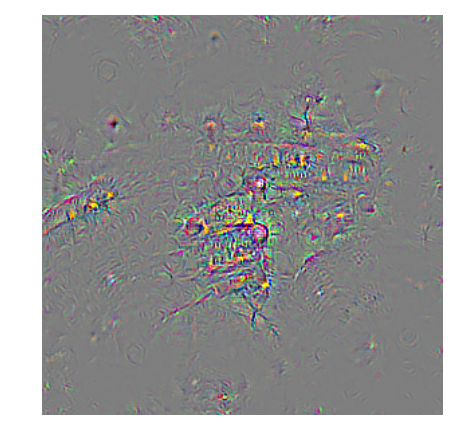

In [73]:
decay = 0.95

img_copy = img_noise.copy()
imgs = []
for it_i in range(n_iterations):
    print(it_i, end=', ')
    this_res = sess.run(gradient[0], feed_dict={
        x: img_copy,
        layer: layer_vec})[0]
    this_res /= (np.max(np.abs(this_res)) + 1e-8)
    img_copy += this_res * step
    img_copy *= decay
    if it_i % gif_step == 0:
        imgs.append(normalize(img_copy[0]))
gif.build_gif(imgs, saveto='3-decay-' + str(neuron_i) + '.gif')

# Blurring  the Gradient

In [74]:
from scipy.ndimage.filters import gaussian_filter

sigma = 1.0
blur_step = 5

0, 1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12, 13, 14, 15, 16, 17, 18, 19, 20, 21, 22, 23, 24, 25, 26, 27, 28, 29, 30, 31, 32, 33, 34, 35, 36, 37, 38, 39, 40, 41, 42, 43, 44, 45, 46, 47, 48, 49, 50, 51, 52, 53, 54, 55, 56, 57, 58, 59, 60, 61, 62, 63, 64, 65, 66, 67, 68, 69, 70, 71, 72, 73, 74, 75, 76, 77, 78, 79, 80, 81, 82, 83, 84, 85, 86, 87, 88, 89, 90, 91, 92, 93, 94, 95, 96, 97, 98, 99, 100, 101, 102, 103, 104, 105, 106, 107, 108, 109, 110, 111, 112, 113, 114, 115, 116, 117, 118, 119, 120, 121, 122, 123, 124, 125, 126, 127, 128, 129, 130, 131, 132, 133, 134, 135, 136, 137, 138, 139, 140, 141, 142, 143, 144, 145, 146, 147, 148, 149, 150, 151, 152, 153, 154, 155, 156, 157, 158, 159, 160, 161, 162, 163, 164, 165, 166, 167, 168, 169, 170, 171, 172, 173, 174, 175, 176, 177, 178, 179, 180, 181, 182, 183, 184, 185, 186, 187, 188, 189, 190, 191, 192, 193, 194, 195, 196, 197, 198, 199, 200, 201, 202, 203, 204, 205, 206, 207, 208, 209, 210, 211, 212, 213, 214, 215, 216, 217, 218, 219, 220, 221, 

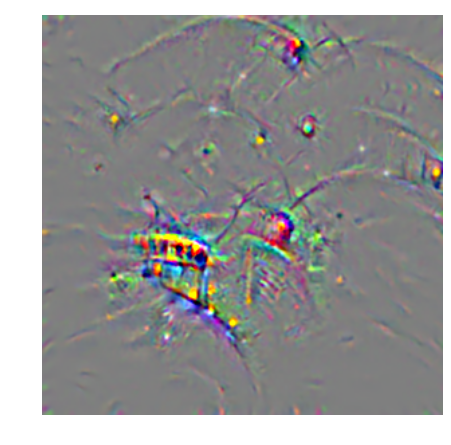

In [75]:
img_copy = img_noise.copy()
imgs = []
for it_i in range(n_iterations):
    print(it_i, end=', ')
    this_res = sess.run(gradient[0], feed_dict={ x: img_copy, layer: layer_vec})[0]
    this_res /= (np.max(np.abs(this_res))+1e-8)
    img_copy += this_res * step
    img_copy *= decay
    if it_i % blur_step == 0:
        for ch_i in range(3):
            img_copy[..., ch_i] = gaussian_filter(img_copy[..., ch_i], sigma)
    if it_i % gif_step ==0 :
        imgs.append(normalize(img_copy[0]))
gif.build_gif(imgs, saveto='4-gaussian-'+str(neuron_i)+'.gif')

In [76]:
ipyd.Image(url='4-gaussian-962.gif', height=300, width=300)

# Clipping Gradients

0, 1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12, 13, 14, 15, 16, 17, 18, 19, 20, 21, 22, 23, 24, 25, 26, 27, 28, 29, 30, 31, 32, 33, 34, 35, 36, 37, 38, 39, 40, 41, 42, 43, 44, 45, 46, 47, 48, 49, 50, 51, 52, 53, 54, 55, 56, 57, 58, 59, 60, 61, 62, 63, 64, 65, 66, 67, 68, 69, 70, 71, 72, 73, 74, 75, 76, 77, 78, 79, 80, 81, 82, 83, 84, 85, 86, 87, 88, 89, 90, 91, 92, 93, 94, 95, 96, 97, 98, 99, 100, 101, 102, 103, 104, 105, 106, 107, 108, 109, 110, 111, 112, 113, 114, 115, 116, 117, 118, 119, 120, 121, 122, 123, 124, 125, 126, 127, 128, 129, 130, 131, 132, 133, 134, 135, 136, 137, 138, 139, 140, 141, 142, 143, 144, 145, 146, 147, 148, 149, 150, 151, 152, 153, 154, 155, 156, 157, 158, 159, 160, 161, 162, 163, 164, 165, 166, 167, 168, 169, 170, 171, 172, 173, 174, 175, 176, 177, 178, 179, 180, 181, 182, 183, 184, 185, 186, 187, 188, 189, 190, 191, 192, 193, 194, 195, 196, 197, 198, 199, 200, 201, 202, 203, 204, 205, 206, 207, 208, 209, 210, 211, 212, 213, 214, 215, 216, 217, 218, 219, 220, 221, 

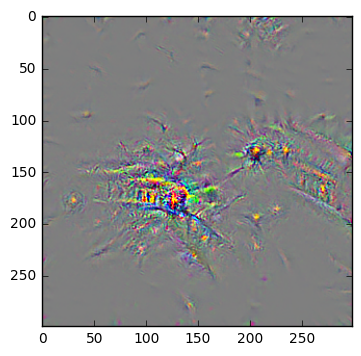

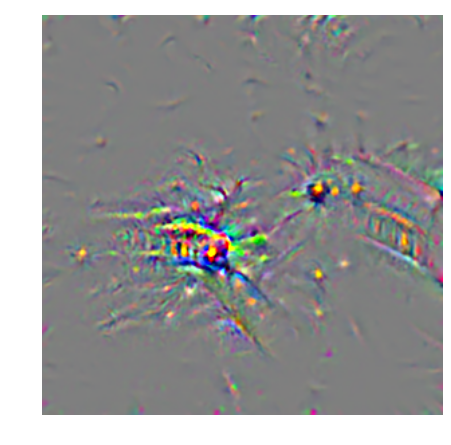

In [77]:
pth = 5

img_copy = img_noise.copy()
imgs = []
for it_i in range(n_iterations):
    print(it_i, end = ', ')
    this_res = sess.run(gradient[0], feed_dict={
        x: img_copy, 
        layer: layer_vec})[0]
    
    this_res /= (np.max(np.abs(this_res)) + 1e-8)
    img_copy += this_res * step
    img_copy *= decay
    if it_i % blur_step == 0:
        for ch_i in range(3):
            img_copy[..., ch_i] = gaussian_filter(img_copy[..., ch_i], sigma)
    
    mask = (abs(img_copy) < np.percentile(abs(img_copy), pth))
    img_copy = img_copy - img_copy* mask
    
    if it_i % gif_step == 0:
        imgs.append(normalize(img_copy[0]))
plt.imshow(normalize(img_copy[0]))
gif.build_gif(imgs, saveto='5-clip-' + str(neuron_i)+'.gif')

In [78]:
ipyd.Image(url='5-clip-962.gif', height=300, width=300)

# Infinite Zoom / Fractal

In [79]:
from skimage.transform import resize

0, 1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12, 13, 14, 15, 16, 17, 18, 19, 20, 21, 22, 23, 24, 25, 26, 27, 28, 29, 30, 31, 32, 33, 34, 35, 36, 37, 38, 39, 40, 41, 42, 43, 44, 45, 46, 47, 48, 49, 50, 51, 52, 53, 54, 55, 56, 57, 58, 59, 60, 61, 62, 63, 64, 65, 66, 67, 68, 69, 70, 71, 72, 73, 74, 75, 76, 77, 78, 79, 80, 81, 82, 83, 84, 85, 86, 87, 88, 89, 90, 91, 92, 93, 94, 95, 96, 97, 98, 99, 100, 101, 102, 103, 104, 105, 106, 107, 108, 109, 110, 111, 112, 113, 114, 115, 116, 117, 118, 119, 120, 121, 122, 123, 124, 125, 126, 127, 128, 129, 130, 131, 132, 133, 134, 135, 136, 137, 138, 139, 140, 141, 142, 143, 144, 145, 146, 147, 148, 149, 150, 151, 152, 153, 154, 155, 156, 157, 158, 159, 160, 161, 162, 163, 164, 165, 166, 167, 168, 169, 170, 171, 172, 173, 174, 175, 176, 177, 178, 179, 180, 181, 182, 183, 184, 185, 186, 187, 188, 189, 190, 191, 192, 193, 194, 195, 196, 197, 198, 199, 200, 201, 202, 203, 204, 205, 206, 207, 208, 209, 210, 211, 212, 213, 214, 215, 216, 217, 218, 219, 220, 221, 

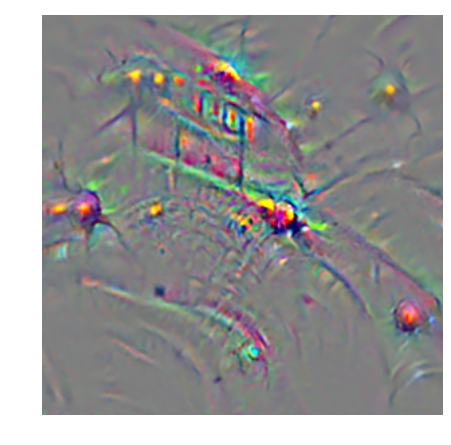

In [80]:
img_copy = img_noise.copy()
crop = 1
n_iterations = 1000
imgs = []
n_img, height, width, ch = img_copy.shape
for it_i in range(n_iterations):
    print(it_i, end =', ')
    this_res = sess.run(gradient[0], feed_dict={ x: img_copy, layer : layer_vec})[0]
    this_res /= (np.max(np.abs(this_res)) + 1e-8)
    img_copy += this_res * step
    img_copy *= decay
    
    if it_i % blur_step == 0:
        for ch_i in range(3):
            img_copy[..., ch_i] = gaussian_filter(img_copy[..., ch_i], sigma)
            
    mask = (abs(img_copy) < np.percentile(abs(img_copy), pth))
    img_copy = img_copy - img_copy * mask
    img_copy = img_copy[:, crop:-crop, crop: -crop, :]
    
    img_copy = resize(img_copy[0], (height, width), order=3, 
                         clip=False, preserve_range=True)[np.newaxis].astype(np.float32)
    
    if it_i % gif_step == 0:
        imgs.append(normalize(img_copy[0]))
gif.build_gif(imgs, saveto='6-fractal.gif')

In [81]:
ipyd.Image(url='6-fractal.gif', height=300, width=300)

# Style Net

In [82]:
import tensorflow as tf
from libs import utils

In [83]:
from tensorflow.python.framework.ops import reset_default_graph
sess.close()
reset_default_graph()

# VGG 16

In [84]:
from libs import vgg16
net =vgg16.get_vgg_model()

In [85]:
g = tf.Graph()
with tf.Session(graph=g) as sess: # g.device('/cpu:0')
    tf.import_graph_def(net['graph_def'], name='vgg')
    names = [op.name for op in g.get_operations()]

In [86]:
nb_utils.show_graph(net['graph_def'])

In [87]:
print(names)

['vgg/images', 'vgg/mul/y', 'vgg/mul', 'vgg/split/split_dim', 'vgg/split', 'vgg/sub/y', 'vgg/sub', 'vgg/sub_1/y', 'vgg/sub_1', 'vgg/sub_2/y', 'vgg/sub_2', 'vgg/concat/concat_dim', 'vgg/concat', 'vgg/conv1_1/filter', 'vgg/conv1_1/Conv2D', 'vgg/conv1_1/biases', 'vgg/conv1_1/BiasAdd', 'vgg/conv1_1/conv1_1', 'vgg/conv1_2/filter', 'vgg/conv1_2/Conv2D', 'vgg/conv1_2/biases', 'vgg/conv1_2/BiasAdd', 'vgg/conv1_2/conv1_2', 'vgg/pool1', 'vgg/conv2_1/filter', 'vgg/conv2_1/Conv2D', 'vgg/conv2_1/biases', 'vgg/conv2_1/BiasAdd', 'vgg/conv2_1/conv2_1', 'vgg/conv2_2/filter', 'vgg/conv2_2/Conv2D', 'vgg/conv2_2/biases', 'vgg/conv2_2/BiasAdd', 'vgg/conv2_2/conv2_2', 'vgg/pool2', 'vgg/conv3_1/filter', 'vgg/conv3_1/Conv2D', 'vgg/conv3_1/biases', 'vgg/conv3_1/BiasAdd', 'vgg/conv3_1/conv3_1', 'vgg/conv3_2/filter', 'vgg/conv3_2/Conv2D', 'vgg/conv3_2/biases', 'vgg/conv3_2/BiasAdd', 'vgg/conv3_2/conv3_2', 'vgg/conv3_3/filter', 'vgg/conv3_3/Conv2D', 'vgg/conv3_3/biases', 'vgg/conv3_3/BiasAdd', 'vgg/conv3_3/conv3_

In [88]:
x = g.get_tensor_by_name(names[0] +':0')
softmax = g.get_tensor_by_name(names[-2]+ ':0')

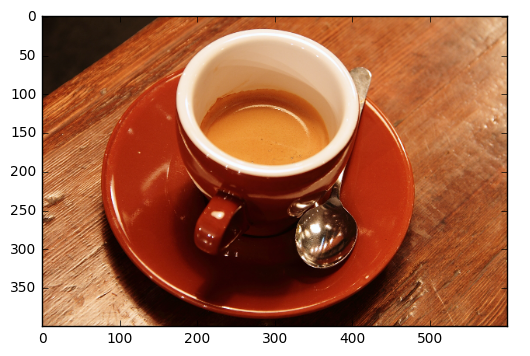

In [89]:
from skimage.data import coffee
og = coffee()
plt.imshow(og)

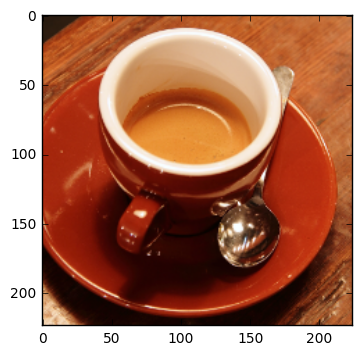

In [90]:
img=vgg16.preprocess(og)
plt.imshow(img)

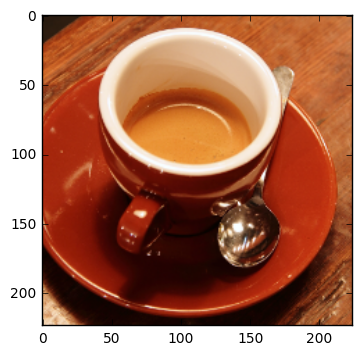

In [91]:
plt.imshow(vgg16.deprocess(img))

In [92]:
vgg16.deprocess(img)

array([[[ 39,  26,  15],
        [ 40,  27,  16],
        [ 39,  26,  16],
        ..., 
        [204, 128,  75],
        [206, 129,  76],
        [209, 133,  78]],

       [[ 39,  26,  15],
        [ 41,  28,  17],
        [ 39,  26,  15],
        ..., 
        [207, 129,  76],
        [207, 131,  79],
        [206, 132,  80]],

       [[ 39,  26,  15],
        [ 41,  28,  17],
        [ 40,  27,  16],
        ..., 
        [205, 131,  78],
        [198, 125,  77],
        [189, 117,  70]],

       ..., 
       [[238, 200, 161],
        [237, 202, 165],
        [243, 215, 181],
        ..., 
        [176,  90,  43],
        [202, 113,  61],
        [184, 103,  49]],

       [[241, 206, 170],
        [239, 210, 177],
        [242, 209, 174],
        ..., 
        [200, 111,  62],
        [183, 106,  53],
        [167,  83,  37]],

       [[240, 203, 169],
        [243, 210, 178],
        [234, 198, 163],
        ..., 
        [174,  95,  46],
        [165,  86,  45],
        [195, 104,

In [93]:
img_4d = img[np.newaxis]
with tf.Session(graph=g) as sess : #g.device('/cpu:0')
    res = softmax.eval(feed_dict={x: img_4d})[0]
    print([(res[idx], net['labels'][idx])
          for idx in res.argsort()[-5:][::-1]])

[(0.97978848, (967, 'n07920052 espresso')), (0.011229442, (968, 'n07930864 cup')), (0.005174425, (925, 'n07584110 consomme')), (0.0014286274, (960, 'n07836838 chocolate sauce, chocolate syrup')), (0.0012511342, (504, 'n03063599 coffee mug'))]


In [94]:
[name_i for name_i in names if 'dropout' in name_i]

['vgg/dropout/Shape',
 'vgg/dropout/random_uniform/min',
 'vgg/dropout/random_uniform/range',
 'vgg/dropout/random_uniform/RandomUniform',
 'vgg/dropout/random_uniform/mul',
 'vgg/dropout/random_uniform',
 'vgg/dropout/add/x',
 'vgg/dropout/add',
 'vgg/dropout/Floor',
 'vgg/dropout/mul/y',
 'vgg/dropout/mul',
 'vgg/dropout/mul_1',
 'vgg/dropout_1/Shape',
 'vgg/dropout_1/random_uniform/min',
 'vgg/dropout_1/random_uniform/range',
 'vgg/dropout_1/random_uniform/RandomUniform',
 'vgg/dropout_1/random_uniform/mul',
 'vgg/dropout_1/random_uniform',
 'vgg/dropout_1/add/x',
 'vgg/dropout_1/add',
 'vgg/dropout_1/Floor',
 'vgg/dropout_1/mul/y',
 'vgg/dropout_1/mul',
 'vgg/dropout_1/mul_1']

In [95]:
with tf.Session(graph=g) as sess:
    res = softmax.eval(feed_dict= {
        x:img_4d, 
        'vgg/dropout_1/random_uniform:0':[[1.0]*4096],
        'vgg/dropout/random_uniform:0':[[1.0]*4096]})[0]
print([(res[idx], net['labels'][idx])
      for idx in res.argsort()[-5:][::-1]])

[(0.99999619, (967, 'n07920052 espresso')), (3.868814e-06, (968, 'n07930864 cup')), (5.4153537e-10, (504, 'n03063599 coffee mug')), (3.8138565e-10, (960, 'n07836838 chocolate sauce, chocolate syrup')), (3.2199923e-10, (925, 'n07584110 consomme'))]


# Defining the Content Features

In [96]:
with tf.Session(graph=g) as sess:
    content_layer = 'vgg/conv4_2/conv4_2:0'
    content_features = g.get_tensor_by_name(content_layer).eval(
            session=sess,
            feed_dict={x: img_4d,
                      'vgg/dropout_1/random_uniform:0': [[1.0]*4096],
                      'vgg/dropout/random_uniform:0': [[1.0]*4096]})
print(content_features.shape)

(1, 28, 28, 512)


# Defineing the Style Features

In [97]:
filepath = utils.download('https://upload.wikimedia.org/wikipedia/commons/thumb/a/ae/El_jard%C3%ADn_de_las_Delicias%2C_de_El_Bosco.jpg/640px-El_jard%C3%ADn_de_las_Delicias%2C_de_El_Bosco.jpg')

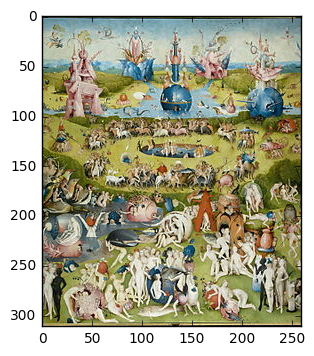

In [98]:
# Note: Unlike in the lecture, I've cropped the image a bit as the borders took over too much...
style_og = plt.imread(filepath)[15:-15, 190:-190, :]
plt.imshow(style_og)

In [99]:
style_img = vgg16.preprocess(style_og)
style_img_4d = style_img[np.newaxis]

In [100]:
with tf.Session(graph=g) as sess:
    res = softmax.eval(
        feed_dict={
            x: style_img_4d,
            'vgg/dropout_1/random_uniform:0': [[1.0]*4096],
            'vgg/dropout/random_uniform:0': [[1.0]*4096]})[0]
print([(res[idx], net['labels'][idx])
       for idx in res.argsort()[-5:][::-1]])

[(0.99336123, (611, 'n03598930 jigsaw puzzle')), (0.0052440544, (868, 'n04476259 tray')), (0.0011667104, (591, 'n03485794 handkerchief, hankie, hanky, hankey')), (0.00011143507, (865, 'n04462240 toyshop')), (4.7309299e-05, (917, 'n06596364 comic book'))]


In [101]:
style_layers = ['vgg/conv1_1/conv1_1:0',
                'vgg/conv2_1/conv2_1:0',
                'vgg/conv3_1/conv3_1:0',
                'vgg/conv4_1/conv4_1:0',
                'vgg/conv5_1/conv5_1:0']

style_activations = []

with tf.Session(graph=g) as sess :
    for style_i in style_layers:
        style_activation_i = g.get_tensor_by_name(style_i).eval(
            feed_dict={
                x:style_img_4d,
                'vgg/dropout_1/random_uniform:0': [[1.0]*4096],
                'vgg/dropout/random_uniform:0': [[1.0]*4096]})
        style_activations.append(style_activation_i)

In [102]:
style_activations[0].shape

(1, 224, 224, 64)

In [103]:
style_features = []
for style_activation_i in style_activations:
    s_i = np.reshape(style_activation_i, [-1, style_activation_i.shape[-1]])
    gram_matrix = np.matmul(s_i.T, s_i) / s_i.size
    print("s_i.shape : {}, gram_matrix.shape : {}".format(s_i.shape, gram_matrix.shape))
    style_features.append(gram_matrix.astype(np.float32))

s_i.shape : (50176, 64), gram_matrix.shape : (64, 64)
s_i.shape : (12544, 128), gram_matrix.shape : (128, 128)
s_i.shape : (3136, 256), gram_matrix.shape : (256, 256)
s_i.shape : (784, 512), gram_matrix.shape : (512, 512)
s_i.shape : (196, 512), gram_matrix.shape : (512, 512)


### Remapping the input

In [104]:
reset_default_graph()
g = tf.Graph()

In [105]:
net = vgg16.get_vgg_model()

with tf.Session(graph=g) as sess:
    net_input = tf.Variable(img_4d, name='variable_for_remap', trainable=True)
    
    tf.import_graph_def(
        net['graph_def'],
        name='vgg',
        input_map={'images:0':net_input})

In [106]:
names = [op.name for op in g.get_operations()]
print(names)

['variable_for_remap/initial_value', 'variable_for_remap', 'variable_for_remap/Assign', 'variable_for_remap/read', 'vgg/images', 'vgg/mul/y', 'vgg/mul', 'vgg/split/split_dim', 'vgg/split', 'vgg/sub/y', 'vgg/sub', 'vgg/sub_1/y', 'vgg/sub_1', 'vgg/sub_2/y', 'vgg/sub_2', 'vgg/concat/concat_dim', 'vgg/concat', 'vgg/conv1_1/filter', 'vgg/conv1_1/Conv2D', 'vgg/conv1_1/biases', 'vgg/conv1_1/BiasAdd', 'vgg/conv1_1/conv1_1', 'vgg/conv1_2/filter', 'vgg/conv1_2/Conv2D', 'vgg/conv1_2/biases', 'vgg/conv1_2/BiasAdd', 'vgg/conv1_2/conv1_2', 'vgg/pool1', 'vgg/conv2_1/filter', 'vgg/conv2_1/Conv2D', 'vgg/conv2_1/biases', 'vgg/conv2_1/BiasAdd', 'vgg/conv2_1/conv2_1', 'vgg/conv2_2/filter', 'vgg/conv2_2/Conv2D', 'vgg/conv2_2/biases', 'vgg/conv2_2/BiasAdd', 'vgg/conv2_2/conv2_2', 'vgg/pool2', 'vgg/conv3_1/filter', 'vgg/conv3_1/Conv2D', 'vgg/conv3_1/biases', 'vgg/conv3_1/BiasAdd', 'vgg/conv3_1/conv3_1', 'vgg/conv3_2/filter', 'vgg/conv3_2/Conv2D', 'vgg/conv3_2/biases', 'vgg/conv3_2/BiasAdd', 'vgg/conv3_2/conv

## Defining the Content Loss

In [107]:
with tf.Session(graph=g) as sess:
    content_loss = tf.nn.l2_loss((g.get_tensor_by_name(content_layer) - 
                                 content_features) /
                                 content_features.size)

## Defining the Style Loss

In [108]:
with tf.Session(graph=g) as sess:
    style_loss = np.float32(0.0)
    for style_layer_i, style_gram_i in zip(style_layers, style_features):
        layer_i = g.get_tensor_by_name(style_layer_i)
        layer_shape = layer_i.get_shape().as_list()
        layer_size = layer_shape[1] * layer_shape[2] * layer_shape[3]
        layer_flat = tf.reshape(layer_i, [-1, layer_shape[3]])
        gram_matrix = tf.matmul(tf.transpose(layer_flat), layer_flat)/ layer_size
        style_loss = tf.add(style_loss, tf.nn.l2_loss((gram_matrix - style_gram_i)/ np.float32(style_gram_i.size)))

In [109]:
a = np.array([[1,2,3,]])

In [110]:
a

array([[1, 2, 3]])

In [111]:
a.transpose()*a

array([[1, 2, 3],
       [2, 4, 6],
       [3, 6, 9]])

## Defining the Total Variation Loss

In [112]:
def total_variation_loss(x):
    h, w = x.get_shape().as_list()[1], x.get_shape().as_list()[1]
    dx = tf.square(x[:, :h-1, w-1, :] - x[:, :h-1, 1:, :])
    dy = tf.square(x[:, :h-1, w-1, :] - x[:, 1:, :w-1, :])
    return tf.reduce_sum(tf.pow(dx + dy, 1.25))

with tf.Session(graph=g) as sess:
    tv_loss = total_variation_loss(net_input)

# Training 

In [113]:
with tf.Session(graph=g) as sess:
    loss = 0.1 * content_loss + 5.0 * style_loss + 0.01* tv_loss
    optimizer = tf.train.AdamOptimizer(0.01).minimize(loss)

0: 213.4837646484375, 0.0, - 1.0


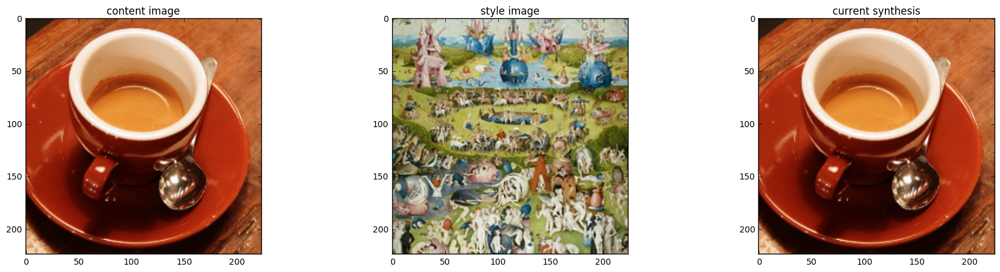

1: 195.78048706054688, -0.009999154135584831, - 1.0099986791610718
2: 179.5853271484375, -0.019981402903795242, - 1.019576072692871
3: 164.8706817626953, -0.02999391034245491, - 1.0294914245605469
4: 151.5860137939453, -0.039849571883678436, - 1.0389851331710815
5: 139.68772888183594, -0.04945063591003418, - 1.0484943389892578


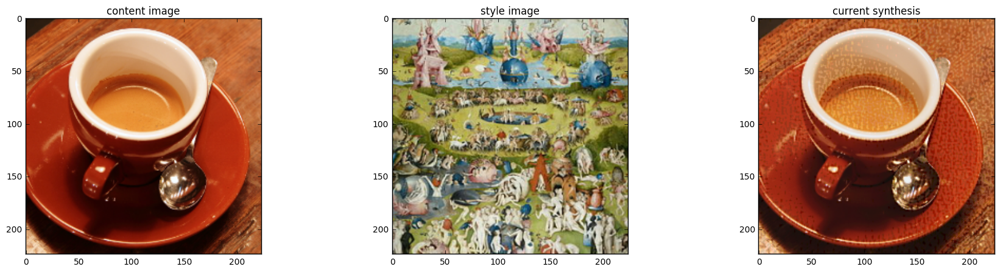

6: 129.10203552246094, -0.058961380273103714, - 1.0578280687332153
7: 119.70409393310547, -0.06803566217422485, - 1.0665825605392456
8: 111.32508087158203, -0.07701914757490158, - 1.073739767074585
9: 103.79255676269531, -0.08514369279146194, - 1.0786811113357544
10: 96.9569091796875, -0.09213708341121674, - 1.0812714099884033


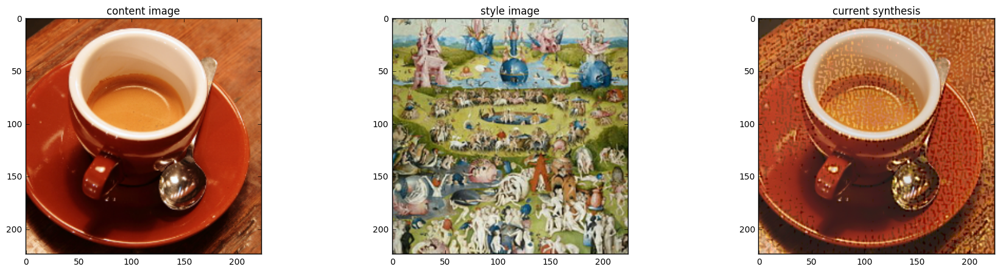

11: 90.70545959472656, -0.0994589552283287, - 1.0846233367919922
12: 84.9635009765625, -0.10656037926673889, - 1.090746521949768
13: 79.6864013671875, -0.11267996579408646, - 1.0960642099380493
14: 74.84613037109375, -0.11783616989850998, - 1.100690245628357
15: 70.41957092285156, -0.12204733490943909, - 1.1047457456588745


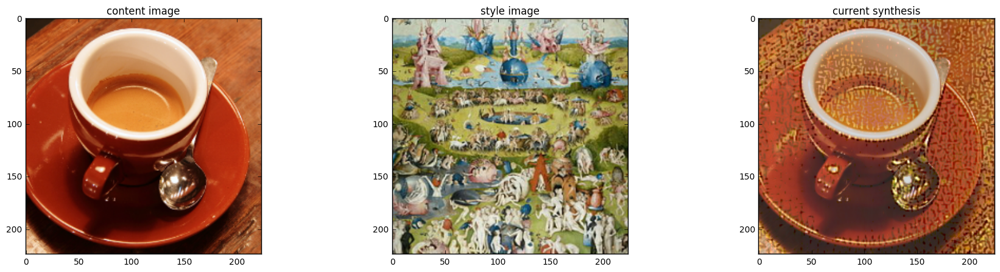

16: 66.38187408447266, -0.12535977363586426, - 1.1083652973175049
17: 62.70103454589844, -0.12787601351737976, - 1.1116656064987183
18: 59.34103775024414, -0.12966252863407135, - 1.1147123575210571
19: 56.26263427734375, -0.13079388439655304, - 1.1175999641418457
20: 53.43082046508789, -0.13135340809822083, - 1.1217211484909058


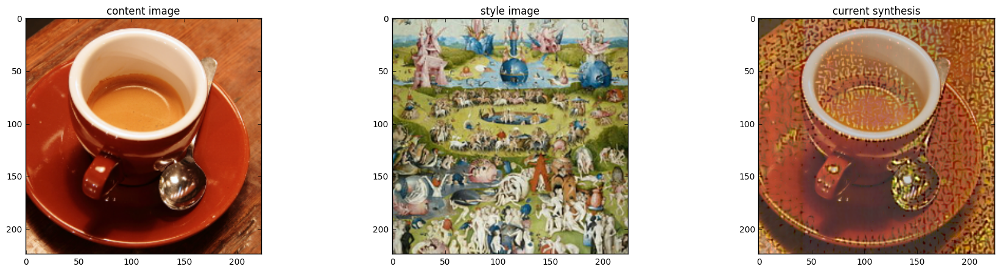

21: 50.815284729003906, -0.13321788609027863, - 1.1281723976135254
22: 48.39257049560547, -0.13833485543727875, - 1.1349022388458252
23: 46.147491455078125, -0.1454227715730667, - 1.1417733430862427
24: 44.068912506103516, -0.15464021265506744, - 1.1486756801605225
25: 42.148860931396484, -0.16390888392925262, - 1.1553813219070435


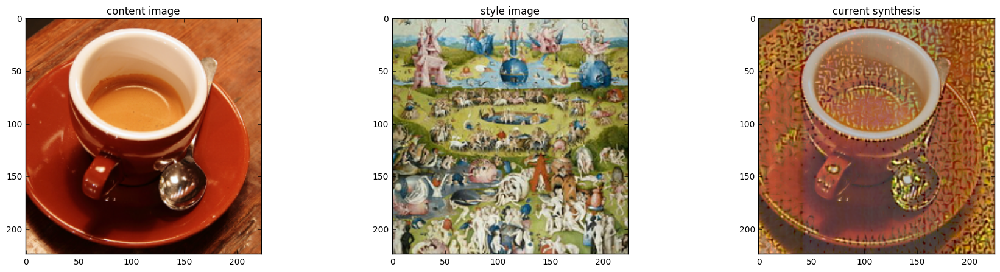

26: 40.38003921508789, -0.17321845889091492, - 1.1616235971450806
27: 38.7519645690918, -0.18250316381454468, - 1.1671615839004517
28: 37.252342224121094, -0.19169723987579346, - 1.1717255115509033
29: 35.86826705932617, -0.20072612166404724, - 1.1751081943511963
30: 34.58740234375, -0.20955504477024078, - 1.1771466732025146


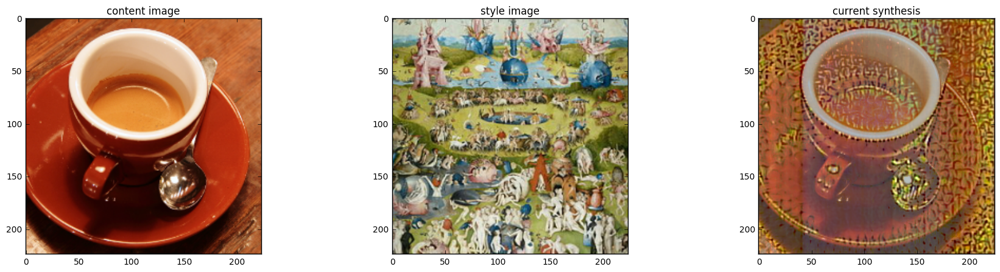

31: 33.39900588989258, -0.21824347972869873, - 1.1778260469436646
32: 32.296165466308594, -0.22678658366203308, - 1.1772208213806152
33: 31.274269104003906, -0.23521387577056885, - 1.1754186153411865
34: 30.329608917236328, -0.2435949146747589, - 1.172531247138977
35: 29.458498001098633, -0.25192540884017944, - 1.1686863899230957


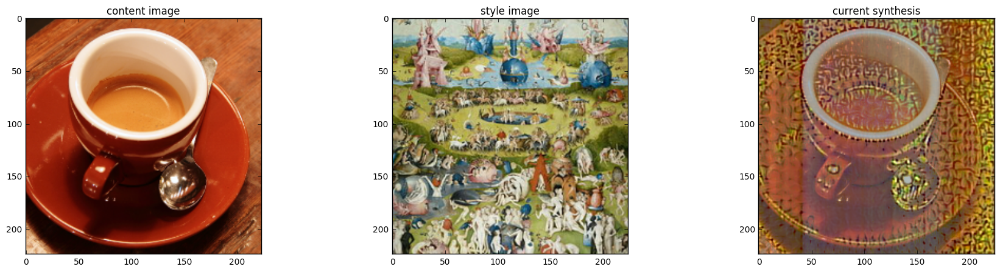

36: 28.65546417236328, -0.26027563214302063, - 1.1640814542770386
37: 27.914012908935547, -0.26871466636657715, - 1.1588395833969116
38: 27.22711944580078, -0.2772948741912842, - 1.1530587673187256
39: 26.587997436523438, -0.28608083724975586, - 1.1468104124069214
40: 25.991558074951172, -0.29504022002220154, - 1.1401365995407104


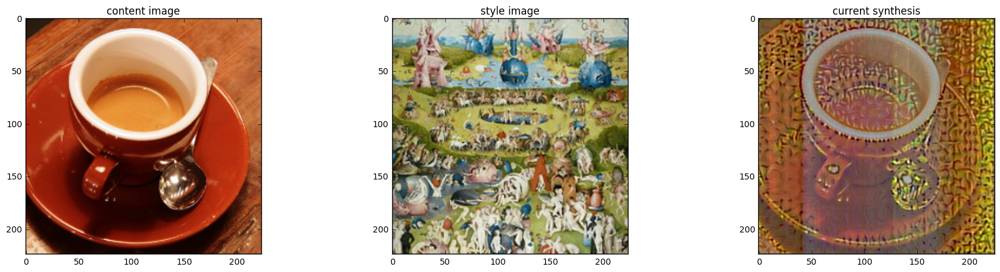

41: 25.434167861938477, -0.3041483163833618, - 1.1330583095550537
42: 24.912277221679688, -0.31340497732162476, - 1.1256147623062134
43: 24.423139572143555, -0.3227751553058624, - 1.117807149887085
44: 23.963361740112305, -0.33219966292381287, - 1.1096341609954834
45: 23.529516220092773, -0.3416523337364197, - 1.1035170555114746


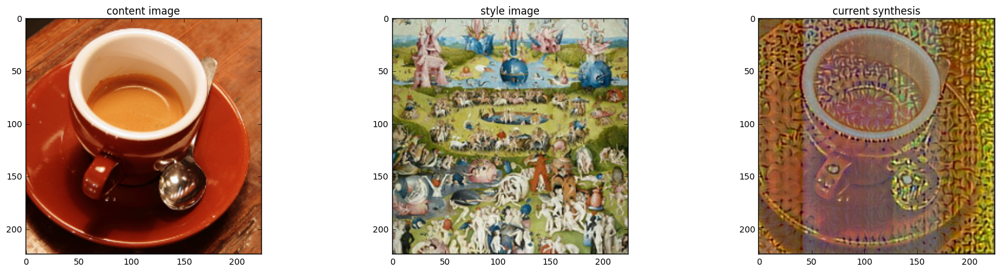

46: 23.11833381652832, -0.35110971331596375, - 1.0989713668823242
47: 22.72637939453125, -0.36055922508239746, - 1.0942459106445312
48: 22.351402282714844, -0.3700239956378937, - 1.0893645286560059
49: 21.992019653320312, -0.3795478343963623, - 1.0843563079833984
50: 21.647863388061523, -0.3891505002975464, - 1.0792564153671265


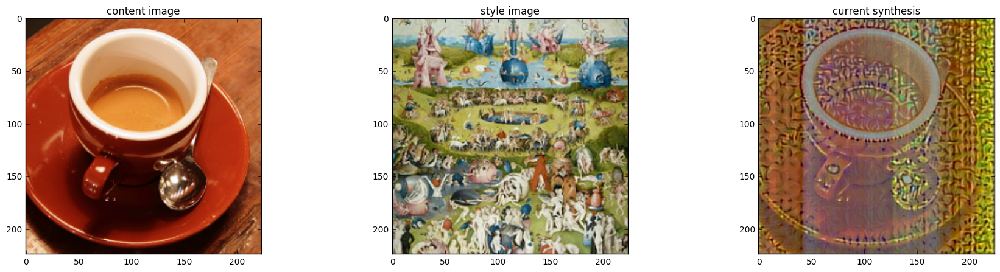

51: 21.318653106689453, -0.39886611700057983, - 1.0740995407104492
52: 21.00347328186035, -0.40872058272361755, - 1.0724278688430786
53: 20.701419830322266, -0.41872748732566833, - 1.0767748355865479
54: 20.41175079345703, -0.42889344692230225, - 1.0809364318847656
55: 20.133665084838867, -0.43923044204711914, - 1.0849229097366333


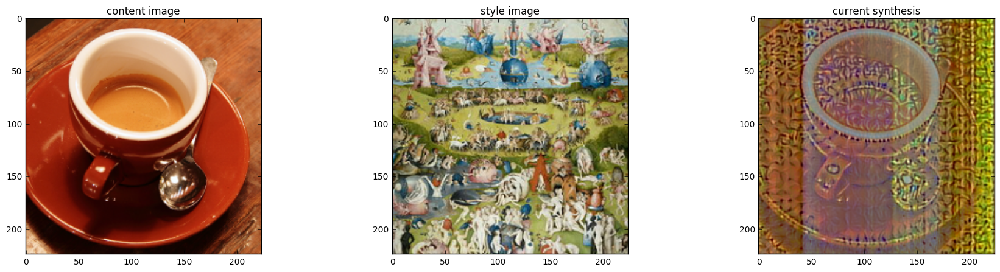

56: 19.866756439208984, -0.449722558259964, - 1.0887199640274048
57: 19.610931396484375, -0.46036237478256226, - 1.0922174453735352
58: 19.365633010864258, -0.47111889719963074, - 1.0953527688980103
59: 19.1304874420166, -0.4819748103618622, - 1.0979533195495605
60: 18.904560089111328, -0.49290764331817627, - 1.099916696548462


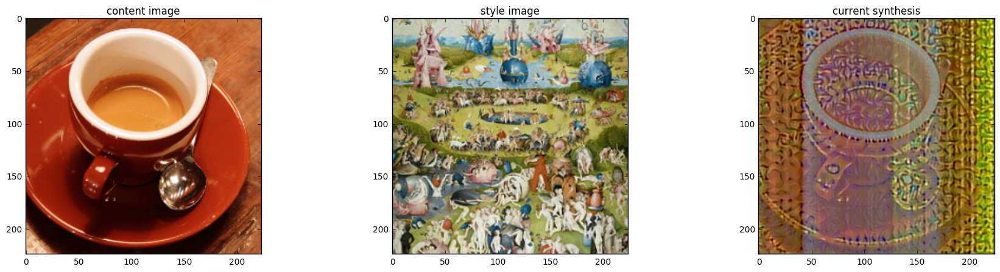

61: 18.687515258789062, -0.5039069056510925, - 1.1012293100357056
62: 18.47869110107422, -0.5149682760238647, - 1.1019349098205566
63: 18.277368545532227, -0.5261016488075256, - 1.101988673210144
64: 18.08351707458496, -0.5373201370239258, - 1.1015442609786987
65: 17.89688491821289, -0.5486332178115845, - 1.1007492542266846


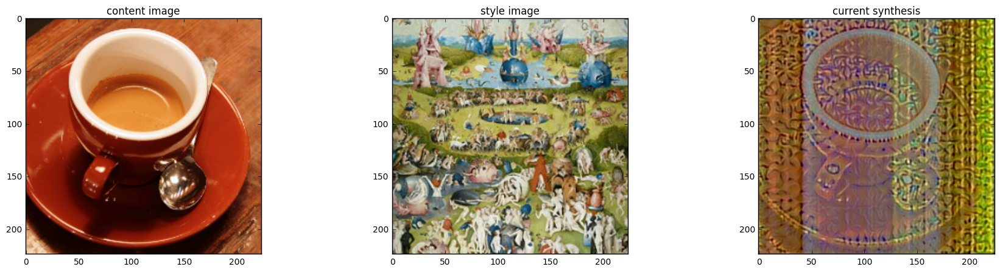

66: 17.71725082397461, -0.560075044631958, - 1.1013103723526
67: 17.54444122314453, -0.5716539621353149, - 1.104843020439148
68: 17.378286361694336, -0.5833961963653564, - 1.107855200767517
69: 17.2186336517334, -0.5952990651130676, - 1.11176598072052
70: 17.064918518066406, -0.6073564887046814, - 1.1169607639312744


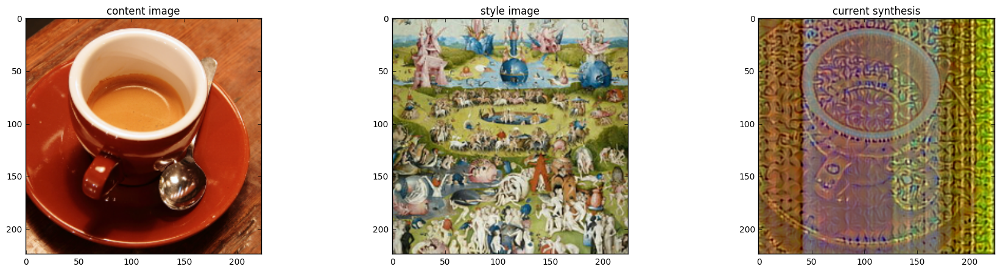

71: 16.91703987121582, -0.6195428371429443, - 1.1217936277389526
72: 16.77486801147461, -0.6318350434303284, - 1.126190185546875
73: 16.638111114501953, -0.6442207098007202, - 1.1300464868545532
74: 16.50653076171875, -0.6566871404647827, - 1.133304476737976
75: 16.37974739074707, -0.66922527551651, - 1.1358760595321655


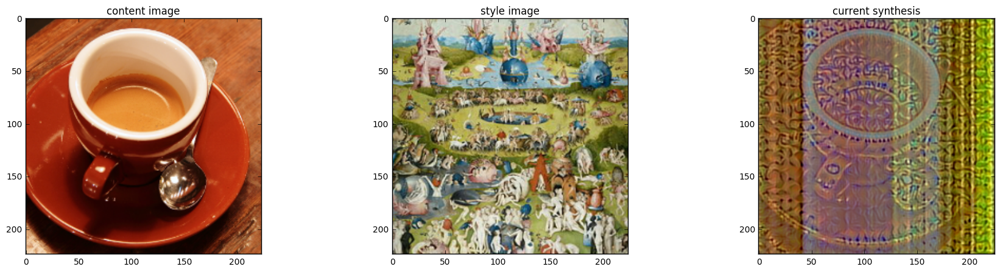

76: 16.25733757019043, -0.6818248629570007, - 1.1378105878829956
77: 16.13909149169922, -0.6944916844367981, - 1.139147400856018
78: 16.025028228759766, -0.7072386145591736, - 1.139939785003662
79: 15.915481567382812, -0.720071017742157, - 1.140236496925354
80: 15.81020736694336, -0.7329792976379395, - 1.143448829650879


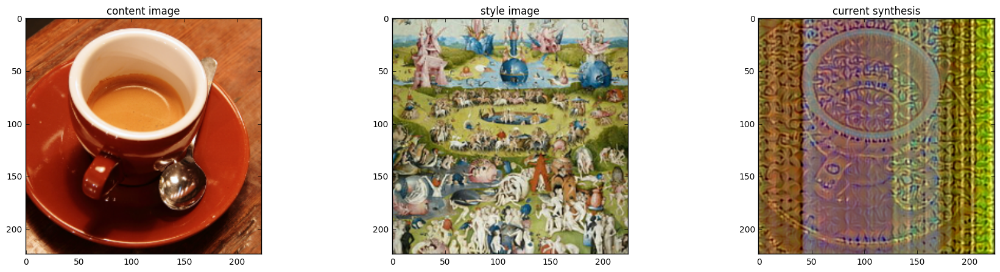

81: 15.708917617797852, -0.74596107006073, - 1.1472272872924805
82: 15.611593246459961, -0.7590177059173584, - 1.1506599187850952
83: 15.517719268798828, -0.7721566557884216, - 1.1537857055664062
84: 15.427125930786133, -0.7853814363479614, - 1.1566078662872314
85: 15.339776992797852, -0.7986876368522644, - 1.159153938293457


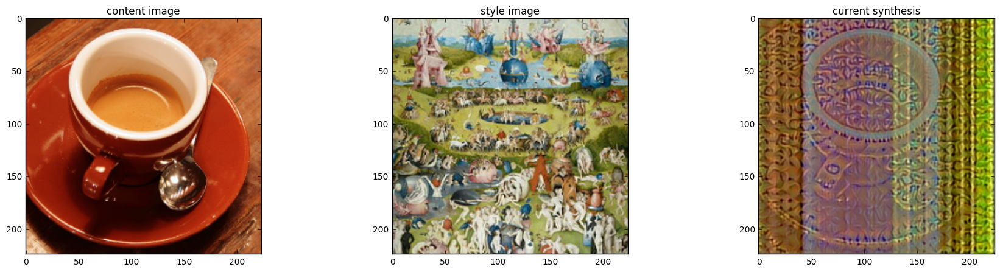

86: 15.255638122558594, -0.8120846748352051, - 1.1614291667938232
87: 15.174493789672852, -0.8255651593208313, - 1.1634273529052734
88: 15.096273422241211, -0.8391234874725342, - 1.1651610136032104
89: 15.020895004272461, -0.8527571558952332, - 1.1666520833969116
90: 14.947897911071777, -0.8664664626121521, - 1.1679573059082031


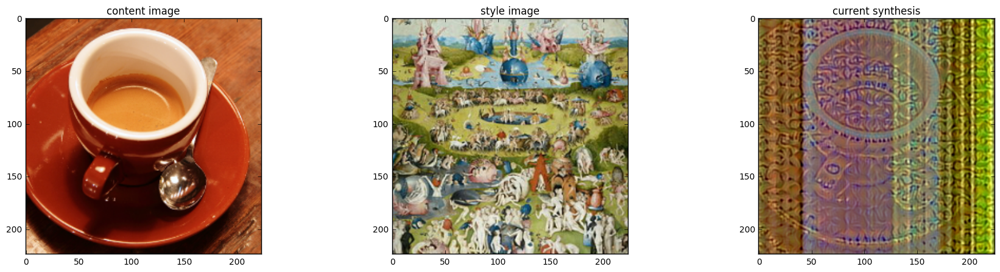

91: 14.87741470336914, -0.8802635669708252, - 1.1692839860916138
92: 14.809453964233398, -0.894151508808136, - 1.1717214584350586
93: 14.743802070617676, -0.9081342816352844, - 1.1739240884780884
94: 14.680362701416016, -0.9222087860107422, - 1.1759220361709595
95: 14.618880271911621, -0.9363746047019958, - 1.1777178049087524


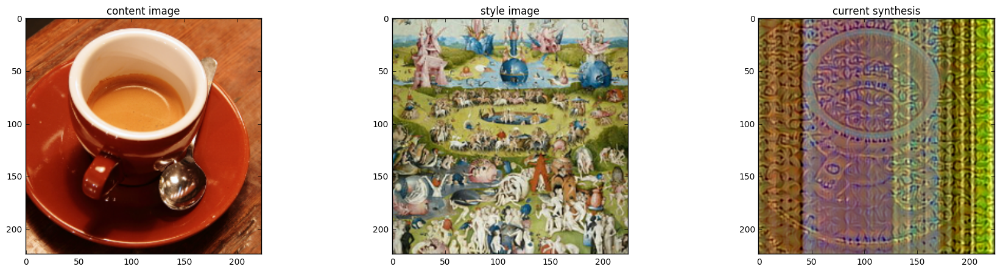

96: 14.559381484985352, -0.9506387710571289, - 1.1800954341888428
97: 14.501832962036133, -0.9650022983551025, - 1.1841784715652466
98: 14.445915222167969, -0.9794532060623169, - 1.1876190900802612
99: 14.3916015625, -0.9939891695976257, - 1.1904598474502563


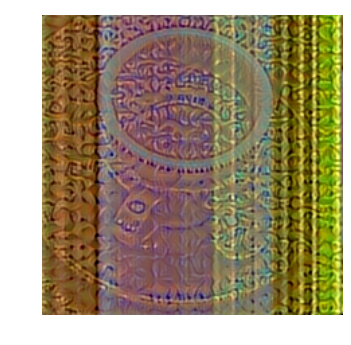

In [114]:
with tf.Session(graph=g) as sess:
    sess.run(tf.global_variables_initializer())
    
    n_iterations = 100
    og_img = net_input.eval()
    imgs = []
    for it_i in range(n_iterations):
        _, this_loss, synth = sess.run([optimizer, loss, net_input], 
                    feed_dict={
                        'vgg/dropout_1/random_uniform:0':
                            np.ones(g.get_tensor_by_name('vgg/dropout_1/random_uniform:0').get_shape().as_list()),
                        'vgg/dropout/random_uniform:0':
                            np.ones(g.get_tensor_by_name(
                            'vgg/dropout/random_uniform:0').get_shape().as_list())})
        print("{}: {}, {}, - {}".format(it_i, this_loss, np.min(synth), np.max(synth)))
        if it_i % 5 == 0:
            imgs.append(np.clip(synth[0], 0, 1))
            fig, ax = plt.subplots(1, 3, figsize = (22, 5))
            ax[0].imshow(vgg16.deprocess(img))
            ax[0].set_title('content image')
            ax[1].imshow(vgg16.deprocess(style_img))
            ax[1].set_title('style image')
            ax[2].imshow(vgg16.deprocess(synth[0]))
            ax[2].set_title('current synthesis')
            plt.show()
            fig.canvas.draw()
    gif.build_gif(imgs, saveto='stylenet_bosch_2.gif')

In [115]:
ipyd.Image(url = 'stylenet_bosch_2.gif', height=300, width=300)